In [1]:
import json
import gzip
from collections import Counter
from itertools import combinations
import glob
import dateutil.parser
import pandas as pd
import os.path

#Make Edgelists from hashtags
First, parse the raw twitter data to make a file for each day with a weighted list of edges (generated in this case from hashtags).

Each file will look like:

```
PCMS champs 3
TeamFairyRose TeamFollowBack 3
instadaily latepost 2
LifeGoals happy 2
DanielaPadillaHoopsForHope TeamBiogesic 2
shoes shopping 5
kordon saatc 3
DID Leg 3
entrepreneur grow 11
Authors Spangaloo 2
```

Store the files in subdirectories, one subdirectory for each day. the directory structure now looks like:
```
twitter/
   20141116/
       weighted_edges_20141116.txt
   20141117/
       weighted_edges_20141117.txt
   20141118/
       weighted_edges_20141118.txt
   etc...
```


In [2]:
files = glob.glob('/mnt/nfs-marketdepth/houghton/data/twitter/raw/posts_sample*.gz')
len(files)

1273

In [3]:
tallydict = {}
for zfile in files:
    print zfile
    with gzip.open(zfile) as gzf:
        for line in gzf:
            parsed_json = json.loads(line)
            if parsed_json.has_key('lang'):
                if parsed_json['lang'] =='en':
                    if len(parsed_json['entities']['hashtags']) >=2:
                        taglist = [entry['text'] for entry in parsed_json['entities']['hashtags']]
                        date = dateutil.parser.parse(parsed_json['created_at']).strftime("%Y%m%d") 
                        if not tallydict.has_key(date):
                            tallydict[date] = Counter()
                        for pair in combinations(taglist, 2):
                            tallydict[date][' '.join(sorted(pair))] += 1

ValueError: Unterminated string starting at: line 1 column 3393 (char 3392)

In [7]:
tallydict

{'20141116': Counter({u'AMAs AOTY': 949, u'MTVStars MTVStars': 855, u'DrashtiDhami SexyList2014': 504, u'SexyList2014 SuperSexyDrashti': 454, u'DrashtiDhami SuperSexyDrashti': 452, u'FanPower SexyList2014': 438, u'AMAs MTVStars': 416, u'TFB TeamFollowBack': 390, u'gameinsight ipadgames': 379, u'RT TFB': 375, u'androidgames gameinsight': 366, u'FOLLOWTRICK MGWV': 358, u'ipad ipadgames': 355, u'FF TFB': 354, u'gameinsight ipad': 353, u'TFB TFW': 349, u'Follow TFB': 349, u'android androidgames': 344, u'RT\u3057\u305f\u4eba\u5168\u54e1\u30d5\u30a9\u30ed\u30fc\u3059\u308b TFB': 343, u'MadisonFollowMe MadisonFollowMe': 341, u'android gameinsight': 334, u'5SOSDERPCON DERPROCKCITY': 333, u'porn sex': 317, u'CAORU TFBJP': 311, u'FREE TFBJP': 302, u'FOLLOW MGWV': 288, u'RETWEETS TFBJP': 274, u'FREE RETWEETS': 273, u'CAORU RETWEETS': 273, u'CAORU FREE': 273, u'AOTY MTVStars': 257, u'SexyList2014 SukirtiKandpal': 244, u'FanPower SukirtiKandpal': 243, u'FOLLOW FOLLOWTRICK': 240, u'porn teen': 239, 

In [5]:
for key in tallydict.keys(): #keys are datestamps
    !mkdir $key
    with open(key+'/weighted_edges_'+key+'.txt', 'w') as fout: #replace old file, instead of append
        for item in tallydict[key].iteritems():
            if item[1] >= 2: #throw out the ones that only have one edge in order to simplify things. The threshold will almost certainly be at least 2.
                fout.write(item[0].encode('utf8')+' '+str(item[1])+'\n')



mkdir: cannot create directory `20141121': File exists
mkdir: cannot create directory `20141120': File exists
mkdir: cannot create directory `20141116': File exists
mkdir: cannot create directory `20141117': File exists
mkdir: cannot create directory `20141118': File exists
mkdir: cannot create directory `20141119': File exists


#Construct unweigheted edgelist

We make an unweighted list of edges by throwing out everything below a certain threshold. We'll do this for a range of different thresholds, so that we can compare the results later. Looks like:

```
VoteOnlyTheYoung VoteOnlyTheYoung
FoxNflSunday tvtag
android free
AZCardinals Lions
usa xxx
كبلز متحرره
LiveInspired LiveInspired
CAORU TEAMANGELS
RT win
FarCry4 Games
```

This is also an undirected graph, so to prevent duplicates, order the two words in alphabetical order.

We do this for thresholds between 2 and 15 (for now, although we may want to change later) so the directory structure looks like:
```
twitter/
   20141116/
       th_02/
           unweighted_20141116_th_02.txt
       th_03/
           unweighted_20141116_th_03.txt
       th_04/
           unweighted_20141116_th_04.txt
       etc...
   20151117/
       th_02/
           unweighted_20141117_th_02.txt
       etc...
   etc...
```

Filenames include the date and the threshold, and the fact that these files are unweighted edge lists.

In [6]:
weighted_files = glob.glob('*/weight*.txt')
weighted_files

['20141120/weighted_edges_20141120.txt',
 '20150312/weighted_edges_20150312.txt',
 '20141117/weighted_edges_20141117.txt',
 '20141118/weighted_edges_20141118.txt',
 '20141116/weighted_edges_20141116.txt',
 '20141119/weighted_edges_20141119.txt',
 '20141121/weighted_edges_20141121.txt']

In [ ]:
for threshold in range (2, 15):
    for infile_name in weighted_files:
        date_dir, weighted_edgefile = infile_name.split('/')
        th_dir = date_dir+'/th_%02i'%threshold
        !mkdir $th_dir

        df = pd.read_csv(infile_name, sep=' ', header=None, names=['Tag1', 'Tag2', 'count'])
        filtered = df[df['count']>threshold][['Tag1','Tag2']]
        outfile_name = th_dir+'/unweighted_'+date_dir+'_th_%02i'%threshold+'.txt'
        with open(outfile_name, 'w') as fout: #replace old file, instead of append
            for index, row in filtered.iterrows():
                fout.write(row['Tag1']+' '+row['Tag2']+'\n')

#Find the communities

We're using [COS Parallel](http://sourceforge.net/p/cosparallel/wiki/Home/) to identify k-cliques, so we feed each unweighted edge file into the `./maximal_cliques` preprocessor, and then the `./cos` algorithm. 

In [ ]:
unweighted_files = glob.glob('*/*/unweight*.txt')
unweighted_files[:5]

In [ ]:
current_directory = os.getcwd()
for infile in unweighted_files:
    th_dir = os.path.dirname(infile)
    th_file = os.path.basename(infile)
    print infile
    !cd $th_dir && /home/houghton/tools/cosparallel-0.99/extras/./maximal_cliques $th_file ; cd $current_directory 

# produces unweighted_edges_20141116.txt.map and unweighted_edges_20141116.txt.mcliques

In [ ]:
maxclique_files = glob.glob('*/*/*.mcliques')
maxclique_files[:5]

In [ ]:
current_directory = os.getcwd()
for infile in maxclique_files:
    mc_dir = os.path.dirname(infile)
    mc_file = os.path.basename(infile)
    print mc_dir, mc_file
    !cd $mc_dir && /home/houghton/tools/cosparallel-0.99/./cos $mc_file ; cd $current_directory 


# Translate back from numbers to actual words
The algorithms we just ran abstract away from the actual text words and give us a result with integer collections and a map back to the original text. So we apply the map to recover the clusters in terms of their original words, and give each cluster a unique identifier:

```
0 Ferguson Anonymous HoodsOff OpKKK
1 Beauty Deals Skin Hair 
2 Family gym sauna selfie
etc...
```



In [ ]:
community_files = glob.glob('*/*/[0-9]*communities.txt')
community_files[:5]

In [ ]:
def read_cluster_file(infile_name):
    """ take a file output from COS and return a """
    clusters = dict()
    with open(infile_name, 'r') as fin:
        for i, line in enumerate(fin):
            name = line.split(':')[0]
            if not clusters.has_key(name):
                clusters[name] = set()
            nodes = line.split(':')[1].split(' ')[:-1]
            for node in nodes:
                clusters[name].add(int(node))
    return clusters        


current_directory = os.getcwd()
for infile in community_files:
    c_dir = os.path.dirname(infile)
    c_file = os.path.basename(infile)
    map_filename = glob.glob('%s/*.map'%c_dir)
    mapping = pd.read_csv(map_filename[0], sep=' ', header=None, names=['word', 'number'], index_col='number')

    clusters = read_cluster_file(infile)
    
    with open(c_dir+'/named'+c_file, 'w') as fout:
        for name, nodes in clusters.iteritems():
            fout.write(' '.join([str(name)]+[mapping.loc[int(node)]['word'] for node in list(nodes)]+['\n']))

# Link cliques day-to-day

Having created each of the cliques, our new task is to trace them through each day. 

Using algorithms developed by Palla, Barbarasi, and Vicsec in Nature(2007):


>**Locating communities.**
>
>In the CPM method, a community is defined as a union of all k-cliques (complete sub-graphs of size k) that can be reached from each other through a series of adjacent k-cliques (where adjacency means sharing k21 nodes). When applied to weighted networks, the CPM has two parameters: the k-clique size k (in Fig. 1a, b we show the communities for k54) and the weight threshold w* (links weaker than w* are ignored). The criterion for selecting these parameters is discussed in the Supplementary Information. 
>
>**Identifying evolving communities.**
>
>The basic idea of the algorithm developed by us to identify community evolution is shown in Fig. 1f. For each pair of consecutive time steps t and t11, we construct a joint graph consisting of the union of links from the corresponding two networks, and extract the CPM community structure of this joint network (I. Dere´nyi, personal communica- tion). Any community from either the t or the t11 snap-shot is contained in exactly one community in the joint graph, as by adding links to a network, the CPM communities can only grow, merge or remain unchanged. Thus, the com- munities in the joint graph provide a natural connection between the commu- nities at t and at t11. If a community in the joint graph contains a single community from t and a single community from t11, then they are matched. If the joint group contains more than one community from either time steps, the communities are matched in descending order of their relative node overlap (see Supplementary

#Create inter-day networks
For every day of data, we create a network which represents the combined edge list of that day and the subsequent day, such that if on day 1 our edge list is:
```
hi there
hi bob
bob rocks
```
and on day 2 our edge list looks like:
```
hi there
smile bob
bob rocks
```
our combined edge list would be:
```
hi there
hi bob
bob rocks
smile bob
```


In [ ]:
dates = glob.glob('201*')
dates.sort()
dates

In [ ]:
#merge multi-day files
for i in range(len(dates)-1):
    merger = dates[i]+'_'+dates[i+1]
    !mkdir $merger
    for th_dir in ['th_%02d'%th for th in range(2, 15) ]:
        merge_th_dir = merger+'/'+th_dir
        !mkdir $merge_th_dir
        current_file_name = glob.glob(dates[i]+'/'+th_dir+'/unwei*.txt')[0]
        next_file_name = glob.glob(dates[i+1]+'/'+th_dir+'/unwei*.txt')[0]    
        merge_file_name = merger+'/'+th_dir+'/unweighted_'+merger+'_'+th_dir+'.txt'
        !cat $current_file_name $next_file_name | sort | uniq > $merge_file_name
    

#find inter-day clusters
We then repeat the process we did above to find clusters by name:

In [ ]:
#make maximal cliques listing
unweighted_files = glob.glob('*_*/*/unweight*.txt')
current_directory = os.getcwd()
for infile in unweighted_files:
    th_dir = os.path.dirname(infile)
    th_file = os.path.basename(infile)
    print infile
    !cd $th_dir && /home/houghton/tools/cosparallel-0.99/extras/./maximal_cliques $th_file ; cd $current_directory 


In [ ]:
#find clusters
maxclique_files = glob.glob('*_*/*/*.mcliques')
current_directory = os.getcwd()
for infile in maxclique_files:
    mc_dir = os.path.dirname(infile)
    mc_file = os.path.basename(infile)
    print mc_dir, mc_file
    !cd $mc_dir && /home/houghton/tools/cosparallel-0.99/./cos $mc_file ; cd $current_directory 

In [ ]:
#go back to actual words
community_files = glob.glob('*_*/*/[0-9]*communities.txt')

current_directory = os.getcwd()
for infile in community_files:
    c_dir = os.path.dirname(infile)
    c_file = os.path.basename(infile)
    map_filename = glob.glob('%s/*.map'%c_dir)
    mapping = pd.read_csv(map_filename[0], sep=' ', header=None, names=['word', 'number'], index_col='number')

    clusters = read_cluster_file(infile)
    
    with open(c_dir+'/named'+c_file, 'w') as fout:
        for name, nodes in clusters.iteritems():
            fout.write(' '.join([str(name)]+[mapping.loc[int(node)]['word'] for node in list(nodes)]+['\n']))


# ----------Still working on the parts below this -------------#


#match clusters
Now we need to use our inter-day clusters to make a map between day1 clusters and day2 clusters.

We should import each cluster as a set, perhaps stored in a pandas series, so that we can keep track of the name?

Then we go through and for each set in the join cluster list, for each set in the left hand side, and for each set in the right hand side, see if the single day set is a subset of the join `s.issubset(t)`. This may be true for multiples of the side sets. Each time it is true, push the pandas series row (name and set) to a new series of 'in play on the left' and 'in play on the right'. Now we should have a small number of candidates for matching with one another.

Now create a matrix with the left hand day elements as rows, and the right hand day elements as columns. In the spaces, count the number of elements of the left hand set in each right hand set. 

We should be able to use this to get the likelihood that each left hand cluster becomes each of the right hand clusters.

We could either leave this transition probability intact, or work forwards, or work backwards...

In [176]:
join_day_filenames = glob.glob('*_*/*/named[0-9]*communities.txt')
#join_day_filenames[0]
join_day_filenames

['20141116_20141117/th_08/named3_communities.txt',
 '20141116_20141117/th_08/named8_communities.txt',
 '20141116_20141117/th_08/named9_communities.txt',
 '20141116_20141117/th_08/named5_communities.txt',
 '20141116_20141117/th_08/named11_communities.txt',
 '20141116_20141117/th_08/named6_communities.txt',
 '20141116_20141117/th_08/named4_communities.txt',
 '20141116_20141117/th_08/named12_communities.txt',
 '20141116_20141117/th_08/named13_communities.txt',
 '20141116_20141117/th_08/named10_communities.txt',
 '20141116_20141117/th_08/named7_communities.txt',
 '20141116_20141117/th_09/named3_communities.txt',
 '20141116_20141117/th_09/named8_communities.txt',
 '20141116_20141117/th_09/named9_communities.txt',
 '20141116_20141117/th_09/named5_communities.txt',
 '20141116_20141117/th_09/named11_communities.txt',
 '20141116_20141117/th_09/named6_communities.txt',
 '20141116_20141117/th_09/named4_communities.txt',
 '20141116_20141117/th_09/named12_communities.txt',
 '20141116_20141117/th_09

In [177]:
join_file_name = join_day_filenames[0]
print join_file_name

dates, th, mergefile = join_file_name.split('/')
current_date, next_date = dates.split('_')
current_file_name = glob.glob(current_date+'/'+th+'/'+mergefile)[0]
print current_file_name

next_file_name = glob.glob(next_date+'/'+th+'/'+mergefile)[0]
print next_file_name


#still working on this bit...

#create a set from each row, and from each row in the corresponding single-day files

20141116_20141117/th_08/named3_communities.txt
20141116/th_08/named3_communities.txt
20141117/th_08/named3_communities.txt


In [ ]:
def read_named_cluster_file(infile_name):
    """ take a file output from COS and return a """
    clusters = dict()
    with open(infile_name, 'r') as fin:
        for i, line in enumerate(fin):
            name = line.split(' ')[0]
            if not clusters.has_key(name):
                clusters[int(name)] = set()
            nodes = line.split(' ')[1:-1]
            for node in nodes:
                clusters[int(name)].add(node)
    return clusters  

##prototype things without intraday clustering
We can use a brute-force matching to create the same type of dataframe that we eventually want to get out of the more nuanced subcluster analysis.

In [173]:
#brute force, without the intra-day clustering
import numpy as np

current_clusters = read_named_cluster_file(current_file_name)
next_clusters = read_named_cluster_file(next_file_name)

def compute_transition_likelihood(current_clusters, next_clusters):
    transition_likelihood = np.empty([max(current_clusters.keys())+1, max(next_clusters.keys())+1])
    for current_cluster, current_elements in current_clusters.iteritems():
        for next_cluster, next_elements in next_clusters.iteritems():
            transition_likelihood[current_cluster, next_cluster] = (
                           len(current_elements & next_elements) ) #the size of the intersection
    return transition_likelihood

transition = compute_transition_likelihood(current_clusters, next_clusters)
transitiondf = pd.DataFrame(data=transition, 
                            index=current_clusters.keys(),
                            columns=next_clusters.keys())
transitiondf

,0,1,2,3,4,5,6,7,8,9,...,232,233,234,235,236,237,238,239,240,241
0,0,59,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,2,86,0,0,0,0,0,0,0,...,0,1,0,1,0,0,1,0,0,0
2,0,0,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,5,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [186]:
for join_file_name in join_day_filenames:
    print join_file_name

    try:
        dates, th, mergefile = join_file_name.split('/')
        current_date, next_date = dates.split('_')
        current_file_name = glob.glob(current_date+'/'+th+'/'+mergefile)[0]
        print current_file_name

        next_file_name = glob.glob(next_date+'/'+th+'/'+mergefile)[0]
        print next_file_name
    
        current_clusters = read_named_cluster_file(current_file_name)
        next_clusters = read_named_cluster_file(next_file_name)

        transition = compute_transition_likelihood(current_clusters, next_clusters)
        transitiondf = pd.DataFrame(data=transition, 
                                index=current_clusters.keys(),
                                columns=next_clusters.keys())

        transitiondf.to_csv(current_file_name[:-4]+'_transition.csv')
    
    except:
        print 'nothing'

20141116_20141117/th_08/named3_communities.txt
20141116/th_08/named3_communities.txt
20141117/th_08/named3_communities.txt
20141116_20141117/th_08/named8_communities.txt
20141116/th_08/named8_communities.txt
20141117/th_08/named8_communities.txt
20141116_20141117/th_08/named9_communities.txt
20141116/th_08/named9_communities.txt
20141117/th_08/named9_communities.txt
20141116_20141117/th_08/named5_communities.txt
20141116/th_08/named5_communities.txt
20141117/th_08/named5_communities.txt
20141116_20141117/th_08/named11_communities.txt
nothing
20141116_20141117/th_08/named6_communities.txt
20141116/th_08/named6_communities.txt
20141117/th_08/named6_communities.txt
20141116_20141117/th_08/named4_communities.txt
20141116/th_08/named4_communities.txt
20141117/th_08/named4_communities.txt
20141116_20141117/th_08/named12_communities.txt
nothing
20141116_20141117/th_08/named13_communities.txt
nothing
20141116_20141117/th_08/named10_communities.txt
nothing
20141116_20141117/th_08/named7_communi

In [181]:
csvfile = current_file_name[:-4]+'_transition.csv'
! cat $csvfile

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241
0,0.0,59.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

Populating the interactive namespace from numpy and matplotlib


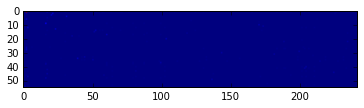

In [175]:
%pylab inline
plt.imshow(transitiondf)

## Use intraday clustering...

In [171]:
join_clusters = read_named_cluster_file(join_file_name)
for join_cluster, join_elements in join_clusters.iteritems():
    current_subclusters = {}
    next_subclusters = {}
    for current_cluster, current_elements in current_clusters.iteritems():
        if current_elements <= join_elements: #subset
            current_subclusters[current_cluster] = current_elements

    for next_cluster, next_elements in next_clusters.iteritems():
        if next_elements <= join_elements: #subset
            next_subclusters[next_cluster] = next_elements
            
    if len(current_subclusters.keys())>1 and len(next_subclusters.keys())>1:
        transition = compute_transition_likelihood(current_subclusters, next_subclusters)
        #transitiondf = pd.DataFrame(data=transition,
        #                            index=current_subclusters.keys(),
        #                            columns=next_subclusters.keys())
        
    elif len(current_subclusters.keys())>1 and len(next_subclusters.keys())>1
    else: #there is only one cluster that it could be...
        

#transitiondf
transition

array([[  0.,  59.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,   0.],
       [  0.,

Lets do some plotting. First need to identify keywords!

So, pick a day, pick a kwd, pick a threshold.

then, look for the keyword in all of the named community files
go to the highest clique community, grab all of those keywords, label with the clique size.
then for each successively smaller clique size, get a community that includes the keyword - should be a superset of the first - label with clique sizes.
If there are multiple... we'll have to deal with that in a bit...

In [222]:
keyword = 'kittens'
threshold = 2
seed_date = '20141116'

date = seed_date

files = pd.DataFrame(glob.glob(date+'/th_%02i'%threshold+'/named*_communities.txt'), columns=['filename'])
files['clique_size']=files['filename'].apply(lambda x: int(x.split('named')[1].split('_')[0])) #brittle
files.sort('clique_size', ascending=False, inplace=True)
#files.apply()


outlist = []
outdict = {}
for index, row in files.iterrows():
    clusters = read_named_cluster_file(row['filename'])
    for index, cluster_set in clusters.iteritems():
        #print cluster_set
        if keyword in cluster_set:
            outdict['date'] = date
            outdict[row['clique_size']] = cluster_set
outlist.append(outdict)
outdict
#print seed_date+'/th_%02i'%threshold+'/named*_communities.txt'

{3: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 4: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 5: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 'date': '20141116'}

In [224]:
outdict

{3: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 4: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 5: {'Ellen', 'Puppies', 'babies', 'horses', 'kittens'},
 'date': '20141116'}

In [223]:
pd.DataFrame(outdict)

,3,4,5,date
0,"set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])",20141116
1,"set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])",20141116
2,"set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])",20141116
3,"set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])",20141116
4,"set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])","set([horses, Puppies, Ellen, babies, kittens])",20141116


In [211]:
files

,filename,clique_size
8,20141116/th_03/named13_communities.txt,13
7,20141116/th_03/named12_communities.txt,12
4,20141116/th_03/named11_communities.txt,11
9,20141116/th_03/named10_communities.txt,10
2,20141116/th_03/named9_communities.txt,9
1,20141116/th_03/named8_communities.txt,8
10,20141116/th_03/named7_communities.txt,7
5,20141116/th_03/named6_communities.txt,6
3,20141116/th_03/named5_communities.txt,5
6,20141116/th_03/named4_communities.txt,4


need functions:

#### get day clusters from keyword
Should include
- the date
- the name of the cluster
- the contents of the cluster
- the clique-size that constructs the cluster



#### get next/previous day associated clusters 
maybe get clusters matching +n days, so you can get one or two or three days into the future?

In [ ]:
def get_clusters_with_keyword(date, threshold, keyword)

    files = pd.DataFrame(glob.glob(date+'/th_%02i'%threshold+'/named*_communities.txt'), columns=['filename'])
    files['clique_size']=files['filename'].apply(lambda x: int(x.split('named')[1].split('_')[0])) #brittle
    files.sort('clique_size', ascending=False, inplace=True)

    outlist = []
    outdict = {}
    
    for index, row in files.iterrows():
        clusters = read_named_cluster_file(row['filename'])
        cumulative_cluster_kewords = set()
        for index, cluster_set in clusters.iteritems():
            #print cluster_set
            if keyword in cluster_set:
                outdict['date'] = date
                outdict[row['clique_size']] = cluster_set - cumulative_cluster_keywords
                cumulative cluster_keywords += cluster_set
    outlist.append(outdict)
    outdict
#print seed_date+'/th_%02i'%threshold+'/named*_communities.txt'


keyword = 'kittens'
threshold = 2
seed_date = '20141116'

In [4]:
pd.DataFrame(outlist)

NameError: name 'outlist' is not defined

In [ ]:
# compressing files older than 2 days
find . -type f -name "*" -mtime +2 -print -exec gzip {} \; 


